In [1]:
import intake
import xarray as xr 
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
from calendar import monthrange
import numpy as np
import cartopy
from tqdm import tqdm
from scipy import interpolate
import pandas as pd
import seaborn as sns
import os
from scipy import stats
from scipy.stats import mannwhitneyu
#%config InlineBackend.figure_format='retina'

from matplotlib import gridspec
from mpl_toolkits.axes_grid1 import make_axes_locatable

dataframe (Dataframe) - contains CMIP6 intake json 

In [2]:
historical_year_start = 2000
historical_year_end = 2014

future_year_start = 2086
future_year_end = 2100

In [3]:
parent_dir = '/home/jovyan/PlanetaryComputerExamples/Paper3/Paper3/Manuscript_final/'
#Saving Sr under different scenarios

In [4]:
# necessary url
url = "https://storage.googleapis.com/cmip6/pangeo-cmip6.json"
# open the catalog
dataframe = intake.open_esm_datastore(url)

In [5]:
import warnings
warnings.filterwarnings("ignore")   

CMIP6_datasets = {}
df = {}
for var in ['evspsbl', 'pr']:
    models = dataframe.search(activity_id = ['CMIP','ScenarioMIP'], experiment_id=['historical','ssp126','ssp245','ssp370','ssp585'], variable_id= str(var), member_id='r1i1p1f1', table_id='Amon')
    CMIP6_datasets[str(var)] = models.to_dataset_dict(zarr_kwargs={"consolidated": True, "decode_times": True, "use_cftime": True})
    #---------Extracting the datasets
    keys = []
    for key in CMIP6_datasets[var].keys():
        keys.append(key);
    keys.sort()
    #---------Splitting the dataset in dataframe
    df1 = pd.DataFrame()
    for i in range(len(keys)):
        df2 = {'institution_id': keys[i].split('.')[1],'source_id': keys[i].split('.')[2],'experiment_id': keys[i].split('.')[3],
               'table_id': keys[i].split('.')[4],'grid_label': keys[i].split('.')[5]};
        df1 = df1.append(df2, ignore_index = True);
    df[str(var)] = df1


--> The keys in the returned dictionary of datasets are constructed as follows:
	'activity_id.institution_id.source_id.experiment_id.table_id.grid_label'



--> The keys in the returned dictionary of datasets are constructed as follows:
	'activity_id.institution_id.source_id.experiment_id.table_id.grid_label'


In [6]:
df = df['evspsbl'][df['evspsbl']['source_id'].isin(df['pr']['source_id'])]

In [7]:
df_final = df.drop_duplicates('source_id').sort_values('source_id').reset_index(drop=True)[['institution_id','source_id','table_id','grid_label']]

In [8]:
df_final['historical'] = 0
df_final['ssp126'] = 0
df_final['ssp245'] = 0
df_final['ssp370'] = 0
df_final['ssp585'] = 0

In [9]:
for model in range(df_final.shape[0]):
    a = df.where((df['source_id'] == df_final.iloc[model,1])).dropna()['experiment_id'].unique()
    if ('historical' in a) == True:
        df_final.iloc[model, 4] = 1
    if ('ssp126' in a) == True:
        df_final.iloc[model, 5] = 1
        if df_final.iloc[model,1] == 'IITM-ESM':
            ## IITM-ESM: Only simulated from 2095-2098
            df_final.iloc[model, 5] = 0
    if ('ssp245' in a) == True:
        df_final.iloc[model, 6] = 1
    if ('ssp370' in a) == True:
        df_final.iloc[model, 7] = 1
        if df_final.iloc[model,1] == 'MPI-ESM-1-2-HAM':
            ## IITM-ESM: Only simulated from 2095-2098
            df_final.iloc[model, 7] = 0
    if ('ssp585' in a) == True:
        df_final.iloc[model, 8] = 1
        if df_final.iloc[model,1] == 'NorESM2-LM':
            # No Precipitation data for NORESM5-ssp585
            df_final.iloc[model, 8] = 0

In [10]:
df_final = df_final[(df_final.source_id != 'EC-Earth3-Veg')]

In [11]:
models_to_remove = np.array(df_final.where((df_final.ssp126==0) & (df_final.ssp245==0) & (df_final.ssp370==0) & (df_final.ssp585 == 0)).dropna()['source_id'])

In [12]:
for model in models_to_remove:
    df_final = df_final[(df_final.source_id != model)]

In [13]:
df_final = df_final.reset_index(drop=True)

In [14]:
df_final

,institution_id,source_id,table_id,grid_label,historical,ssp126,ssp245,ssp370,ssp585
0,CSIRO-ARCCSS,ACCESS-CM2,Amon,gn,1,1,1,1,1
1,CSIRO,ACCESS-ESM1-5,Amon,gn,1,1,0,0,1
2,AWI,AWI-CM-1-1-MR,Amon,gn,1,1,1,1,1
3,BCC,BCC-CSM2-MR,Amon,gn,1,1,1,1,1
4,CAS,CAS-ESM2-0,Amon,gn,1,1,1,1,1
5,NCAR,CESM2-WACCM,Amon,gn,1,1,1,1,1
6,CMCC,CMCC-CM2-SR5,Amon,gn,1,1,1,1,1
7,CMCC,CMCC-ESM2,Amon,gn,1,1,1,1,1
8,CCCma,CanESM5,Amon,gn,1,1,1,1,1
9,E3SM-Project,E3SM-1-1,Amon,gr,1,0,0,0,1


#### Running analysis

In [15]:
# For South America
lat_min, lat_max, lon_min, lon_max = [-35,15,270,330]
if (lon_min == 270) & (lon_max == 330):
    Country = 'South America'
else:
    Country = 'Check country'

#### To calculate root zone storage capacity (Sr) using monthly precipitation and evaporation dataset
##### Need to be run once

### Empirical data

In [16]:
#os.chdir('/home/jovyan/PlanetaryComputerExamples/Paper3')
Sr = xr.open_dataset(parent_dir+'Empirical_data/Data_Rootzone-storage-capacity.nc').mle_gumbel[0]

# Interpolated data
new_lon = Sr.lon.values
new_lat = Sr.lat.values

In [17]:
Landuse_all = xr.open_dataset(parent_dir+'Empirical_data/Landuse_resampled_0.25_lonlatbox.nc').sel(lat = slice(-50,50)).Band1

#Landuse with both forest and savanna
Landuse_with_savanna = Landuse_all.where((Landuse_all == 30) | (Landuse_all == 40) | (Landuse_all == 50) | (Landuse_all == 60) | (Landuse_all == 70) | (Landuse_all == 90) | (Landuse_all == 100) | (Landuse_all == 110) | (Landuse_all == 120) | (Landuse_all == 130) | (Landuse_all == 140) | (Landuse_all == 150))
## Landuse with only forest
Landuse = Landuse_all.where((Landuse_all == 40) | (Landuse_all == 50) | (Landuse_all == 60) | (Landuse_all == 70) | (Landuse_all == 90) | (Landuse_all == 100))
## landuse with only savanna
Landuse_only_savanna = Landuse_all.where((Landuse_all == 30) | (Landuse_all == 110) | (Landuse_all == 120) | (Landuse_all == 130) | (Landuse_all == 140) | (Landuse_all == 150))

In [18]:
def get_iqr_values(df_in, col_name):
    median = df_in[col_name].median()
    q1 = df_in[col_name].quantile(0.25) # 25th percentile / 1st quartile
    q3 = df_in[col_name].quantile(0.75) # 7th percentile / 3rd quartile
    iqr = q3-q1 #Interquartile range
    minimum  = q1-1.5*iqr # The minimum value or the |- marker in the box plot
    maximum = q3+1.5*iqr # The maximum value or the -| marker in the box plot
    return median, q1, q3, iqr, minimum, maximum

def get_iqr_text(df_in, col_name):
    median, q1, q3, iqr, minimum, maximum = get_iqr_values(df_in, col_name)
    text = f"median={median:.2f}, q1={q1:.2f}, q3={q3:.2f}, iqr={iqr:.2f}, minimum={minimum:.2f}, maximum={maximum:.2f}"
    return text

def remove_outliers(df_in, col_name):
    _, _, _, _, minimum, maximum = get_iqr_values(df_in, col_name)
    df_out = df_in.loc[(df_in[col_name] > minimum) & (df_in[col_name] < maximum)]
    return df_out

## For South America

Welch's t-test: https://towardsdatascience.com/the-statistical-analysis-t-test-explained-for-beginners-and-experts-fd0e358bbb62


Mann-Whitney U test 

In [21]:
df_final

,institution_id,source_id,table_id,grid_label,historical,ssp126,ssp245,ssp370,ssp585
0,CSIRO-ARCCSS,ACCESS-CM2,Amon,gn,1,1,1,1,1
1,CSIRO,ACCESS-ESM1-5,Amon,gn,1,1,0,0,1
2,AWI,AWI-CM-1-1-MR,Amon,gn,1,1,1,1,1
3,BCC,BCC-CSM2-MR,Amon,gn,1,1,1,1,1
4,CAS,CAS-ESM2-0,Amon,gn,1,1,1,1,1
5,NCAR,CESM2-WACCM,Amon,gn,1,1,1,1,1
6,CMCC,CMCC-CM2-SR5,Amon,gn,1,1,1,1,1
7,CMCC,CMCC-ESM2,Amon,gn,1,1,1,1,1
8,CCCma,CanESM5,Amon,gn,1,1,1,1,1
9,E3SM-Project,E3SM-1-1,Amon,gr,1,0,0,0,1


In [36]:
## With percentile equivalent threhold

fig, ax = plt.subplots(7,5, figsize=(30,44.5), dpi = 200)
fig.subplots_adjust(bottom=0.02)
sec_y_eq_100 = []
sec_y_eq_400 = []
color = ['#2b8cbe','#2ca25f','#a6611a','#de2d26']
for model, ax in zip(range(df_final.shape[0]), ax.flat):
    os.chdir(parent_dir+'Sr_estimates/historical/')
    temp_name = 'CMIP.'+df_final.iloc[model,0]+'.'+df_final.iloc[model,1]+'.'+'historical'+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
    #if df_final.iloc[model,1] == 'MPI-ESM1-2-HR':
    #    temp_name = 'MPI-M'+'.'+df_final.iloc[model,1]+'.'+'historical'+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
    temp_name = 'Sr-20year-return-period'+'.'+temp_name+'.2000-2014.nc'
    CMIP6_Sr_interp_historical = xr.open_dataset(temp_name).Sr.interp(lat=new_lat, lon=new_lon)
    df = pd.DataFrame({'Sr': Sr.sel(lat = slice(lat_min,lat_max), 
                                        lon = slice(lon_min,lon_max)).where(Landuse.sel(lat = slice(lat_min,lat_max), 
                                                                                        lon = slice(lon_min,lon_max)).values > 0).values.flatten(),
                           'Historical': CMIP6_Sr_interp_historical.sel(lat = slice(lat_min,lat_max), 
                                                             lon = slice(lon_min,lon_max)).where(Landuse.sel(lat = slice(lat_min,lat_max), 
                                                                                                             lon = slice(lon_min,lon_max)).values > 0).values.flatten()})
    SSP = 0
    for SSP in ['ssp126','ssp245','ssp370','ssp585']:
        if df_final[SSP].iloc[model] == 0:
            continue
        os.chdir(parent_dir+'Sr_estimates/'+SSP+'/')
        temp_name = 'ScenarioMIP.'+df_final.iloc[model,0]+'.'+df_final.iloc[model,1]+'.'+str(SSP)+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
        if (df_final.iloc[model,1] == 'MPI-ESM1-2-HR'):
            temp_name = 'ScenarioMIP.'+'DKRZ'+'.'+df_final.iloc[model,1]+'.'+str(SSP)+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
        if (df_final.iloc[model,1] == 'IITM-ESM'):
            if (SSP == 'ssp370'):
                CMIP6_Sr_interp_future = xr.open_dataset('Sr-20year-return-period'+'.'+temp_name+'.'+str(future_year_start)+'-'+str(2098)+'.nc').Sr.interp(lat=new_lat, lon=new_lon)
            else:
                CMIP6_Sr_interp_future = xr.open_dataset('Sr-20year-return-period'+'.'+temp_name+'.'+str(future_year_start)+'-'+str(2099)+'.nc').Sr.interp(lat=new_lat, lon=new_lon)
        else: 
            CMIP6_Sr_interp_future = xr.open_dataset('Sr-20year-return-period'+'.'+temp_name+'.'+str(future_year_start)+'-'+str(future_year_end)+'.nc').Sr.interp(lat=new_lat, lon=new_lon)
        #print(temp_name)

        CMIP6_Sr_interp_future = CMIP6_Sr_interp_future.where(Landuse.values > 0)

        # Converting to dataframe for analysis for 'South America' 
        df[SSP] = CMIP6_Sr_interp_future.sel(lat = slice(lat_min,lat_max), 
                                                             lon = slice(lon_min,lon_max)).where(Landuse.sel(lat = slice(lat_min,lat_max), 
                                                                                                             lon = slice(lon_min,lon_max)).values > 0).values.flatten()
        
    df = df.dropna()
    df_random  = df.sample(3000)
    df_random = remove_outliers(df_random, 'Sr')
    df_random = remove_outliers(df_random, 'Historical')
    
    for SSP in ['ssp126','ssp245','ssp370','ssp585']:
        if df_final[SSP].iloc[model] == 0:
            continue
        df_random = remove_outliers(df_random, SSP)

    sz = df_random['Sr'].size-1
    df_random['Sr_percentile'] = df_random['Sr'].rank(method='max').apply(lambda x: 100.0*(x-1)/sz)    
    df_random['Historical_percentile'] = df_random['Historical'].rank(method='max').apply(lambda x: 100.0*(x-1)/sz)    
    Sr_percentile_100 = df_random.loc[df_random['Sr'].sub(100).abs().idxmin()]['Sr_percentile']
    Historical_Sr_100 = df_random.loc[df_random['Historical_percentile'].sub(Sr_percentile_100).abs().idxmin()]['Historical']
    Sr_percentile_400 = df_random.loc[df_random['Sr'].sub(400).abs().idxmin()]['Sr_percentile']
    Historical_Sr_400 = df_random.loc[df_random['Historical_percentile'].sub(Sr_percentile_400).abs().idxmin()]['Historical']

    newax = ax.twiny()
    newax.set_frame_on(True)
    newax.patch.set_visible(False)
    newax.xaxis.set_ticks_position('bottom')
    newax.xaxis.set_label_position('bottom')
    newax.spines['bottom'].set_position(('outward', 40))
    ax.axvline(100, color = 'black', zorder = 2, alpha = 0.7)
    ax.axvline(400, color = 'black', zorder = 2, alpha = 0.7)
    sns.distplot(df_random['Sr'] , color="black", bins = 100, ax = ax, label = 'Observed', hist=False)
    sns.distplot(df_random['Historical'] , color="black", bins = 100, ax = newax, hist=False, label = 'CMIP6-Historical', kde_kws={'linestyle':'--'})
    sec_y_eq_100.append(Historical_Sr_100)
    newax.axvline(Historical_Sr_100, color = 'black', linestyle = '--', zorder = 2, alpha = 0.9)
    Historical_Sr_100 = 0
    sec_y_eq_400.append(Historical_Sr_400)
    newax.axvline(Historical_Sr_400, color = 'black', linestyle = '--', zorder = 2, alpha = 0.9)
    Historical_Sr_400 = 0
    
    color_i = 0
    for SSP in ['ssp126','ssp245','ssp370','ssp585']:
        if df_final[SSP].iloc[model] == 0:
            color_i = color_i+1
            continue
        sns.distplot(df_random[SSP] , color=color[color_i], bins = 100, ax = newax, hist=False, label = 'CMIP6-Future')
        color_i = color_i+1
        ax.set_title(df_final.iloc[model,1], fontsize = '20', color = '#636363')
        sns.despine()
        ax.tick_params(axis='both', which='major', labelsize=20)
        plt.setp(ax.spines.values(), linewidth=1.5)
        ax.set_xlabel(' ')
        newax.tick_params(axis='x', which='major', labelsize=20)
        newax.spines['bottom'].set_color('dodgerblue')

        plt.setp(newax.spines.values(), linewidth=1.5)
        ax.set_ylabel(' ')
        newax.set_xlabel(' ')
    if (stats.ttest_ind(df['Sr'].sample(20), df['Historical'].sample(20))[1] < 0.05):
        ax.annotate('p < 0.05', xy=(0.89, 0.9), xycoords='axes fraction', style='italic', fontsize=20, ha='right', va='bottom', zorder = 5)
    else:
        ax.annotate('p = '+'{0:.3f}'.format(stats.ttest_ind(df['Sr'].sample(20), df['Historical'].sample(20))[1]), xy=(0.89, 0.9), 
                    xycoords='axes fraction', style='italic', fontsize=20, ha='right', va='bottom', zorder = 5)

df_final['Sr-100eq'] = np.array(sec_y_eq_100)
df_final['Sr-400eq'] = np.array(sec_y_eq_400)

fig.text(0.5, -0.01, 'Root zone storage capacity (mm)', ha='center', fontsize = 36)

fig.text(0.05, 1.01, 'Observation-based vs CMIP6-derived root zone storage capacity distribution for '+Country, fontsize = 36)
#fig.text(0.23735, 1.01, 'CMIP6-historical (2000-2014)', fontsize = 36, color = 'dodgerblue')
#fig.text(0.4858, 1.01, 'vs', fontsize = 36)
#fig.text(0.51, 1.01, 'CMIP6-'+SSP+' (2070-2100)', fontsize = 36, color = 'red') # Check the year
#fig.text(0.736, 1.01, ' for '+Country, fontsize = 36)

fig.text(-0.02, 0.5, 'Frequency density', va='center', rotation='vertical', fontsize = 36)
#fig.text(0.5,1.018, '(Percentile-relative)', ha='center', fontsize = 25, color = '#636363')
plt.tight_layout()
#fig.savefig(parent_dir+'/Figures/'+Country+'_Frequency_distribution (Observed vs Historical vs Future).svg', dpi=300, bbox_inches="tight")


In [66]:
stat, p = mannwhitneyu(df['Sr'].sample(5000), df['Historical'].sample(5000))
print('Statistics=%.3f, p=%.3f' % (stat, p))
# interpret
alpha = 0.05
if p > alpha:
    print('Same distribution (fail to reject H0)')
else:
    print('Different distribution (reject H0)')

Statistics=12080266.000, p=0.004
Different distribution (reject H0)


In [73]:
stat, p = stats.ks_2samp(df['Sr'].sample(2000), df['Historical'].sample(2000))
print('Statistics=%.3f, p=%.3f' % (stat, p))
# interpret
alpha = 0.05
if p > alpha:
    print('Same distribution (fail to reject H0)')
else:
    print('Different distribution (reject H0)')

Statistics=0.155, p=0.000
Different distribution (reject H0)


In [20]:
## With percentile equivalent threhold

fig, ax = plt.subplots(7,5, figsize=(30,44.5), dpi = 200)
fig.subplots_adjust(bottom=0.02)
sec_y_eq_100 = []
sec_y_eq_400 = []
color = ['#2b8cbe','#2ca25f','#a6611a','#de2d26']
for model, ax in zip(range(df_final.shape[0]), ax.flat):
    os.chdir(parent_dir+'Sr_estimates/historical/')
    temp_name = 'CMIP.'+df_final.iloc[model,0]+'.'+df_final.iloc[model,1]+'.'+'historical'+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
    #if df_final.iloc[model,1] == 'MPI-ESM1-2-HR':
    #    temp_name = 'MPI-M'+'.'+df_final.iloc[model,1]+'.'+'historical'+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
    temp_name = 'Sr-20year-return-period'+'.'+temp_name+'.2000-2014.nc'
    CMIP6_Sr_interp_historical = xr.open_dataset(temp_name).Sr.interp(lat=new_lat, lon=new_lon)
    df = pd.DataFrame({'Sr': Sr.sel(lat = slice(lat_min,lat_max), 
                                        lon = slice(lon_min,lon_max)).where(Landuse.sel(lat = slice(lat_min,lat_max), 
                                                                                        lon = slice(lon_min,lon_max)).values > 0).values.flatten(),
                           'Historical': CMIP6_Sr_interp_historical.sel(lat = slice(lat_min,lat_max), 
                                                             lon = slice(lon_min,lon_max)).where(Landuse.sel(lat = slice(lat_min,lat_max), 
                                                                                                             lon = slice(lon_min,lon_max)).values > 0).values.flatten()})
    SSP = 0
    for SSP in ['ssp126','ssp245','ssp370','ssp585']:
        if df_final[SSP].iloc[model] == 0:
            continue
        os.chdir(parent_dir+'Sr_estimates/'+SSP+'/')
        temp_name = 'ScenarioMIP.'+df_final.iloc[model,0]+'.'+df_final.iloc[model,1]+'.'+str(SSP)+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
        if (df_final.iloc[model,1] == 'MPI-ESM1-2-HR'):
            temp_name = 'ScenarioMIP.'+'DKRZ'+'.'+df_final.iloc[model,1]+'.'+str(SSP)+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
        if (df_final.iloc[model,1] == 'IITM-ESM'):
            if (SSP == 'ssp370'):
                CMIP6_Sr_interp_future = xr.open_dataset('Sr-20year-return-period'+'.'+temp_name+'.'+str(future_year_start)+'-'+str(2098)+'.nc').Sr.interp(lat=new_lat, lon=new_lon)
            else:
                CMIP6_Sr_interp_future = xr.open_dataset('Sr-20year-return-period'+'.'+temp_name+'.'+str(future_year_start)+'-'+str(2099)+'.nc').Sr.interp(lat=new_lat, lon=new_lon)
        else: 
            CMIP6_Sr_interp_future = xr.open_dataset('Sr-20year-return-period'+'.'+temp_name+'.'+str(future_year_start)+'-'+str(future_year_end)+'.nc').Sr.interp(lat=new_lat, lon=new_lon)
        #print(temp_name)

        CMIP6_Sr_interp_future = CMIP6_Sr_interp_future.where(Landuse.values > 0)

        # Converting to dataframe for analysis for 'South America' 
        df[SSP] = CMIP6_Sr_interp_future.sel(lat = slice(lat_min,lat_max), 
                                                             lon = slice(lon_min,lon_max)).where(Landuse.sel(lat = slice(lat_min,lat_max), 
                                                                                                             lon = slice(lon_min,lon_max)).values > 0).values.flatten()
        
    df = df.dropna()
    df_random  = df.sample(3000)
    df_random = remove_outliers(df_random, 'Sr')
    df_random = remove_outliers(df_random, 'Historical')
    
    for SSP in ['ssp126','ssp245','ssp370','ssp585']:
        if df_final[SSP].iloc[model] == 0:
            continue
        df_random = remove_outliers(df_random, SSP)

    sz = df_random['Sr'].size-1
    df_random['Sr_percentile'] = df_random['Sr'].rank(method='max').apply(lambda x: 100.0*(x-1)/sz)    
    df_random['Historical_percentile'] = df_random['Historical'].rank(method='max').apply(lambda x: 100.0*(x-1)/sz)    
    Sr_percentile_100 = df_random.loc[df_random['Sr'].sub(100).abs().idxmin()]['Sr_percentile']
    Historical_Sr_100 = df_random.loc[df_random['Historical_percentile'].sub(Sr_percentile_100).abs().idxmin()]['Historical']
    Sr_percentile_400 = df_random.loc[df_random['Sr'].sub(400).abs().idxmin()]['Sr_percentile']
    Historical_Sr_400 = df_random.loc[df_random['Historical_percentile'].sub(Sr_percentile_400).abs().idxmin()]['Historical']

    newax = ax.twiny()
    newax.set_frame_on(True)
    newax.patch.set_visible(False)
    newax.xaxis.set_ticks_position('bottom')
    newax.xaxis.set_label_position('bottom')
    newax.spines['bottom'].set_position(('outward', 40))
    ax.axvline(100, color = 'black', zorder = 2, alpha = 0.7)
    ax.axvline(400, color = 'black', zorder = 2, alpha = 0.7)
    sns.distplot(df_random['Sr'] , color="black", bins = 100, ax = ax, label = 'Observed', hist=False)
    sns.distplot(df_random['Historical'] , color="black", bins = 100, ax = newax, hist=False, label = 'CMIP6-Historical', kde_kws={'linestyle':'--'})
    sec_y_eq_100.append(Historical_Sr_100)
    newax.axvline(Historical_Sr_100, color = 'black', linestyle = '--', zorder = 2, alpha = 0.9)
    Historical_Sr_100 = 0
    sec_y_eq_400.append(Historical_Sr_400)
    newax.axvline(Historical_Sr_400, color = 'black', linestyle = '--', zorder = 2, alpha = 0.9)
    Historical_Sr_400 = 0
    
    color_i = 0
    for SSP in ['ssp126','ssp245','ssp370','ssp585']:
        if df_final[SSP].iloc[model] == 0:
            color_i = color_i+1
            continue
        sns.distplot(df_random[SSP] , color=color[color_i], bins = 100, ax = newax, hist=False, label = 'CMIP6-Future')
        color_i = color_i+1
        ax.set_title(df_final.iloc[model,1], fontsize = '20', color = '#636363')
        sns.despine()
        ax.tick_params(axis='both', which='major', labelsize=20)
        plt.setp(ax.spines.values(), linewidth=1.5)
        ax.set_xlabel(' ')
        newax.tick_params(axis='x', which='major', labelsize=20)
        newax.spines['bottom'].set_color('dodgerblue')

        plt.setp(newax.spines.values(), linewidth=1.5)
        ax.set_ylabel(' ')
        newax.set_xlabel(' ')
    """
    ax.annotate('p = '+'{0:.3f}'.format(mannwhitneyu(df['Sr'].sample(2000), df['Historical'].sample(2000))[1]), xy=(0.89, 0.9), 
                    xycoords='axes fraction', style='italic', fontsize=20, ha='right', va='bottom', zorder = 5)
    """
    """
    if (mannwhitneyu(df['Sr'].sample(2000), df['Historical'].sample(2000))[1] < 0.05):
        ax.annotate('p < 0.05', xy=(0.89, 0.9), xycoords='axes fraction', style='italic', fontsize=20, ha='right', va='bottom', zorder = 5, color = 'red')
    else:
        ax.annotate('p = '+'{0:.3f}'.format(mannwhitneyu(df['Sr'].sample(20), df['Historical'].sample(20))[1]), xy=(0.89, 0.9), 
                    xycoords='axes fraction', style='italic', fontsize=20, ha='right', va='bottom', zorder = 5)
    """
df_final['Sr-100eq'] = np.array(sec_y_eq_100)
df_final['Sr-400eq'] = np.array(sec_y_eq_400)

fig.text(0.5, -0.01, 'Root zone storage capacity (mm)', ha='center', fontsize = 36)

fig.text(0.05, 1.01, 'Observation-based vs CMIP6-derived root zone storage capacity distribution for '+Country, fontsize = 36)
#fig.text(0.23735, 1.01, 'CMIP6-historical (2000-2014)', fontsize = 36, color = 'dodgerblue')
#fig.text(0.4858, 1.01, 'vs', fontsize = 36)
#fig.text(0.51, 1.01, 'CMIP6-'+SSP+' (2070-2100)', fontsize = 36, color = 'red') # Check the year
#fig.text(0.736, 1.01, ' for '+Country, fontsize = 36)

fig.text(-0.02, 0.5, 'Density', va='center', rotation='vertical', fontsize = 36)
#fig.text(0.5,1.018, '(Percentile-relative)', ha='center', fontsize = 25, color = '#636363')
plt.tight_layout()
fig.savefig(parent_dir+'/Figures/Supplementary_Fig2_Frequency_distribution (Observed vs Historical vs Future).tif', dpi=300, bbox_inches="tight")

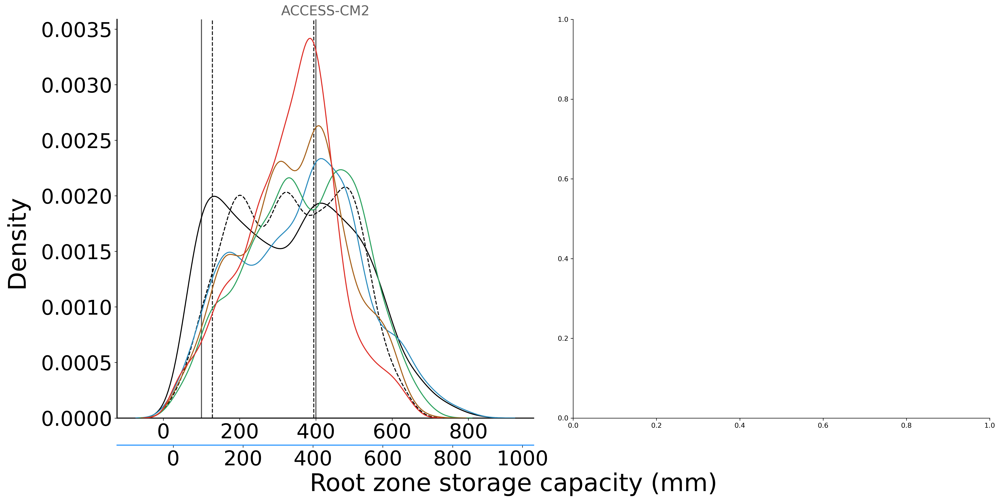

In [31]:
## With percentile equivalent threhold

fig, ax = plt.subplots(1,2, figsize=(20,10), dpi = 300)
fig.subplots_adjust(bottom=0.02)
sec_y_eq_100 = []
sec_y_eq_400 = []
color = ['#2b8cbe','#2ca25f','#a6611a','#de2d26']
for model, ax in zip(range(1), ax.flat):
    os.chdir(parent_dir+'Sr_estimates/historical/')
    temp_name = 'CMIP.'+df_final.iloc[model,0]+'.'+df_final.iloc[model,1]+'.'+'historical'+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
    #if df_final.iloc[model,1] == 'MPI-ESM1-2-HR':
    #    temp_name = 'MPI-M'+'.'+df_final.iloc[model,1]+'.'+'historical'+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
    temp_name = 'Sr-20year-return-period'+'.'+temp_name+'.2000-2014.nc'
    CMIP6_Sr_interp_historical = xr.open_dataset(temp_name).Sr.interp(lat=new_lat, lon=new_lon)
    df = pd.DataFrame({'Sr': Sr.sel(lat = slice(lat_min,lat_max), 
                                        lon = slice(lon_min,lon_max)).where(Landuse.sel(lat = slice(lat_min,lat_max), 
                                                                                        lon = slice(lon_min,lon_max)).values > 0).values.flatten(),
                           'Historical': CMIP6_Sr_interp_historical.sel(lat = slice(lat_min,lat_max), 
                                                             lon = slice(lon_min,lon_max)).where(Landuse.sel(lat = slice(lat_min,lat_max), 
                                                                                                             lon = slice(lon_min,lon_max)).values > 0).values.flatten()})
    SSP = 0
    for SSP in ['ssp126','ssp245','ssp370','ssp585']:
        if df_final[SSP].iloc[model] == 0:
            continue
        os.chdir(parent_dir+'Sr_estimates/'+SSP+'/')
        temp_name = 'ScenarioMIP.'+df_final.iloc[model,0]+'.'+df_final.iloc[model,1]+'.'+str(SSP)+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
        if (df_final.iloc[model,1] == 'MPI-ESM1-2-HR'):
            temp_name = 'ScenarioMIP.'+'DKRZ'+'.'+df_final.iloc[model,1]+'.'+str(SSP)+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
        if (df_final.iloc[model,1] == 'IITM-ESM'):
            if (SSP == 'ssp370'):
                CMIP6_Sr_interp_future = xr.open_dataset('Sr-20year-return-period'+'.'+temp_name+'.'+str(future_year_start)+'-'+str(2098)+'.nc').Sr.interp(lat=new_lat, lon=new_lon)
            else:
                CMIP6_Sr_interp_future = xr.open_dataset('Sr-20year-return-period'+'.'+temp_name+'.'+str(future_year_start)+'-'+str(2099)+'.nc').Sr.interp(lat=new_lat, lon=new_lon)
        else: 
            CMIP6_Sr_interp_future = xr.open_dataset('Sr-20year-return-period'+'.'+temp_name+'.'+str(future_year_start)+'-'+str(future_year_end)+'.nc').Sr.interp(lat=new_lat, lon=new_lon)
        #print(temp_name)

        CMIP6_Sr_interp_future = CMIP6_Sr_interp_future.where(Landuse.values > 0)

        # Converting to dataframe for analysis for 'South America' 
        df[SSP] = CMIP6_Sr_interp_future.sel(lat = slice(lat_min,lat_max), 
                                                             lon = slice(lon_min,lon_max)).where(Landuse.sel(lat = slice(lat_min,lat_max), 
                                                                                                             lon = slice(lon_min,lon_max)).values > 0).values.flatten()
        
    df = df.dropna()
    df_random  = df.sample(3000)
    df_random = remove_outliers(df_random, 'Sr')
    df_random = remove_outliers(df_random, 'Historical')
    
    for SSP in ['ssp126','ssp245','ssp370','ssp585']:
        if df_final[SSP].iloc[model] == 0:
            continue
        df_random = remove_outliers(df_random, SSP)

    sz = df_random['Sr'].size-1
    df_random['Sr_percentile'] = df_random['Sr'].rank(method='max').apply(lambda x: 100.0*(x-1)/sz)    
    df_random['Historical_percentile'] = df_random['Historical'].rank(method='max').apply(lambda x: 100.0*(x-1)/sz)    
    Sr_percentile_100 = df_random.loc[df_random['Sr'].sub(100).abs().idxmin()]['Sr_percentile']
    Historical_Sr_100 = df_random.loc[df_random['Historical_percentile'].sub(Sr_percentile_100).abs().idxmin()]['Historical']
    Sr_percentile_400 = df_random.loc[df_random['Sr'].sub(400).abs().idxmin()]['Sr_percentile']
    Historical_Sr_400 = df_random.loc[df_random['Historical_percentile'].sub(Sr_percentile_400).abs().idxmin()]['Historical']

    newax = ax.twiny()
    newax.set_frame_on(True)
    newax.patch.set_visible(False)
    newax.xaxis.set_ticks_position('bottom')
    newax.xaxis.set_label_position('bottom')
    newax.spines['bottom'].set_position(('outward', 40))
    ax.axvline(100, color = 'black', zorder = 2, alpha = 0.7)
    ax.axvline(400, color = 'black', zorder = 2, alpha = 0.7)
    sns.distplot(df_random['Sr'] , color="black", bins = 100, ax = ax, label = 'Observed', hist=False)
    sns.distplot(df_random['Historical'] , color="black", bins = 100, ax = newax, hist=False, label = 'CMIP6-Historical', kde_kws={'linestyle':'--'})
    sec_y_eq_100.append(Historical_Sr_100)
    newax.axvline(Historical_Sr_100, color = 'black', linestyle = '--', zorder = 2, alpha = 0.9)
    Historical_Sr_100 = 0
    sec_y_eq_400.append(Historical_Sr_400)
    newax.axvline(Historical_Sr_400, color = 'black', linestyle = '--', zorder = 2, alpha = 0.9)
    Historical_Sr_400 = 0
    
    color_i = 0
    for SSP in ['ssp126','ssp245','ssp370','ssp585']:
        if df_final[SSP].iloc[model] == 0:
            color_i = color_i+1
            continue
        sns.distplot(df_random[SSP] , color=color[color_i], bins = 100, ax = newax, hist=False, label = 'CMIP6-Future')
        color_i = color_i+1
        ax.set_title(df_final.iloc[model,1], fontsize = '20', color = '#636363')
        sns.despine()
        ax.tick_params(axis='both', which='major', labelsize=30)
        plt.setp(ax.spines.values(), linewidth=1.5)
        ax.set_xlabel(' ')
        newax.tick_params(axis='x', which='major', labelsize=30)
        newax.spines['bottom'].set_color('dodgerblue')

        plt.setp(newax.spines.values(), linewidth=1.5)
        ax.set_ylabel(' ')
        newax.set_xlabel(' ')
    """
    ax.annotate('p = '+'{0:.3f}'.format(mannwhitneyu(df['Sr'].sample(2000), df['Historical'].sample(2000))[1]), xy=(0.89, 0.9), 
                    xycoords='axes fraction', style='italic', fontsize=20, ha='right', va='bottom', zorder = 5)
    """
    """
    if (mannwhitneyu(df['Sr'].sample(2000), df['Historical'].sample(2000))[1] < 0.05):
        ax.annotate('p < 0.05', xy=(0.89, 0.9), xycoords='axes fraction', style='italic', fontsize=20, ha='right', va='bottom', zorder = 5, color = 'red')
    else:
        ax.annotate('p = '+'{0:.3f}'.format(mannwhitneyu(df['Sr'].sample(20), df['Historical'].sample(20))[1]), xy=(0.89, 0.9), 
                    xycoords='axes fraction', style='italic', fontsize=20, ha='right', va='bottom', zorder = 5)
    """

fig.text(0.5, -0.01, 'Root zone storage capacity (mm)', ha='center', fontsize = 36)

#fig.text(0.05, 1.01, 'Observation-based vs CMIP6-derived root zone storage capacity distribution for '+Country, fontsize = 36)
#fig.text(0.23735, 1.01, 'CMIP6-historical (2000-2014)', fontsize = 36, color = 'dodgerblue')
#fig.text(0.4858, 1.01, 'vs', fontsize = 36)
#fig.text(0.51, 1.01, 'CMIP6-'+SSP+' (2070-2100)', fontsize = 36, color = 'red') # Check the year
#fig.text(0.736, 1.01, ' for '+Country, fontsize = 36)

fig.text(-0.02, 0.5, 'Density', va='center', rotation='vertical', fontsize = 36)
#fig.text(0.5,1.018, '(Percentile-relative)', ha='center', fontsize = 25, color = '#636363')
plt.tight_layout()
fig.savefig(parent_dir+'/Figures/Supplementary_Fig7a.svg', dpi=300, bbox_inches="tight")

In [23]:
df_final

,institution_id,source_id,table_id,grid_label,historical,ssp126,ssp245,ssp370,ssp585,Sr-100eq,Sr-400eq
0,CSIRO-ARCCSS,ACCESS-CM2,Amon,gn,1,1,1,1,1,116.575532,409.900705
1,CSIRO,ACCESS-ESM1-5,Amon,gn,1,1,0,0,1,95.728133,314.000824
2,AWI,AWI-CM-1-1-MR,Amon,gn,1,1,1,1,1,127.053403,446.708181
3,BCC,BCC-CSM2-MR,Amon,gn,1,1,1,1,1,93.549910,348.750239
4,CAS,CAS-ESM2-0,Amon,gn,1,1,1,1,1,120.418121,336.189765
5,NCAR,CESM2-WACCM,Amon,gn,1,1,1,1,1,164.953056,445.445854
6,CMCC,CMCC-CM2-SR5,Amon,gn,1,1,1,1,1,155.168020,288.220768
7,CMCC,CMCC-ESM2,Amon,gn,1,1,1,1,1,147.600075,282.739693
8,CCCma,CanESM5,Amon,gn,1,1,1,1,1,194.054560,337.462342
9,E3SM-Project,E3SM-1-1,Amon,gr,1,0,0,0,1,165.402306,338.410103


In [24]:
df_final.to_csv(parent_dir+'/CMIP6-Future_models_all_(with Sr-eq)_'+Country+'.csv', index = False)

#### For Africa

In [32]:
# For South America
lat_min, lat_max, lon_min, lon_max = [-35,15,0,55]
if (lon_min == 0) & (lon_max == 55):
    Country = 'Africa'
else:
    Country = 'Check country'

In [34]:
## With percentile equivalent threhold

fig, ax = plt.subplots(7,5, figsize=(30,44.5), dpi = 200)
fig.subplots_adjust(bottom=0.02)
sec_y_eq_100 = []
sec_y_eq_400 = []
color = ['#2b8cbe','#2ca25f','#a6611a','#de2d26']
for model, ax in zip(range(df_final.shape[0]), ax.flat):
    os.chdir(parent_dir+'Sr_estimates/historical/')
    temp_name = 'CMIP.'+df_final.iloc[model,0]+'.'+df_final.iloc[model,1]+'.'+'historical'+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
    #if df_final.iloc[model,1] == 'MPI-ESM1-2-HR':
    #    temp_name = 'MPI-M'+'.'+df_final.iloc[model,1]+'.'+'historical'+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
    temp_name = 'Sr-20year-return-period'+'.'+temp_name+'.2000-2014.nc'
    CMIP6_Sr_interp_historical = xr.open_dataset(temp_name).Sr.interp(lat=new_lat, lon=new_lon)
    df = pd.DataFrame({'Sr': Sr.sel(lat = slice(lat_min,lat_max), 
                                        lon = slice(lon_min,lon_max)).where(Landuse.sel(lat = slice(lat_min,lat_max), 
                                                                                        lon = slice(lon_min,lon_max)).values > 0).values.flatten(),
                           'Historical': CMIP6_Sr_interp_historical.sel(lat = slice(lat_min,lat_max), 
                                                             lon = slice(lon_min,lon_max)).where(Landuse.sel(lat = slice(lat_min,lat_max), 
                                                                                                             lon = slice(lon_min,lon_max)).values > 0).values.flatten()})
    SSP = 0
    for SSP in ['ssp126','ssp245','ssp370','ssp585']:
        if df_final[SSP].iloc[model] == 0:
            continue
        os.chdir(parent_dir+'Sr_estimates/'+SSP+'/')
        temp_name = 'ScenarioMIP.'+df_final.iloc[model,0]+'.'+df_final.iloc[model,1]+'.'+str(SSP)+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
        if (df_final.iloc[model,1] == 'MPI-ESM1-2-HR'):
            temp_name = 'ScenarioMIP.'+'DKRZ'+'.'+df_final.iloc[model,1]+'.'+str(SSP)+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
        if (df_final.iloc[model,1] == 'IITM-ESM'):
            if (SSP == 'ssp370'):
                CMIP6_Sr_interp_future = xr.open_dataset('Sr-20year-return-period'+'.'+temp_name+'.'+str(future_year_start)+'-'+str(2098)+'.nc').Sr.interp(lat=new_lat, lon=new_lon)
            else:
                CMIP6_Sr_interp_future = xr.open_dataset('Sr-20year-return-period'+'.'+temp_name+'.'+str(future_year_start)+'-'+str(2099)+'.nc').Sr.interp(lat=new_lat, lon=new_lon)
        else: 
            CMIP6_Sr_interp_future = xr.open_dataset('Sr-20year-return-period'+'.'+temp_name+'.'+str(future_year_start)+'-'+str(future_year_end)+'.nc').Sr.interp(lat=new_lat, lon=new_lon)
        #print(temp_name)

        CMIP6_Sr_interp_future = CMIP6_Sr_interp_future.where(Landuse.values > 0)

        # Converting to dataframe for analysis for 'South America' 
        df[SSP] = CMIP6_Sr_interp_future.sel(lat = slice(lat_min,lat_max), 
                                                             lon = slice(lon_min,lon_max)).where(Landuse.sel(lat = slice(lat_min,lat_max), 
                                                                                                             lon = slice(lon_min,lon_max)).values > 0).values.flatten()
        
    df = df.dropna()
    df_random  = df.sample(3000)
    df_random = remove_outliers(df_random, 'Sr')
    df_random = remove_outliers(df_random, 'Historical')
    
    for SSP in ['ssp126','ssp245','ssp370','ssp585']:
        if df_final[SSP].iloc[model] == 0:
            continue
        df_random = remove_outliers(df_random, SSP)

    sz = df_random['Sr'].size-1
    df_random['Sr_percentile'] = df_random['Sr'].rank(method='max').apply(lambda x: 100.0*(x-1)/sz)    
    df_random['Historical_percentile'] = df_random['Historical'].rank(method='max').apply(lambda x: 100.0*(x-1)/sz)    
    Sr_percentile_100 = df_random.loc[df_random['Sr'].sub(100).abs().idxmin()]['Sr_percentile']
    Historical_Sr_100 = df_random.loc[df_random['Historical_percentile'].sub(Sr_percentile_100).abs().idxmin()]['Historical']
    Sr_percentile_400 = df_random.loc[df_random['Sr'].sub(350).abs().idxmin()]['Sr_percentile']
    Historical_Sr_400 = df_random.loc[df_random['Historical_percentile'].sub(Sr_percentile_400).abs().idxmin()]['Historical']

    newax = ax.twiny()
    newax.set_frame_on(True)
    newax.patch.set_visible(False)
    newax.xaxis.set_ticks_position('bottom')
    newax.xaxis.set_label_position('bottom')
    newax.spines['bottom'].set_position(('outward', 40))
    ax.axvline(100, color = 'black', zorder = 2, alpha = 0.7)
    ax.axvline(350, color = 'black', zorder = 2, alpha = 0.7)
    sns.distplot(df_random['Sr'] , color="black", bins = 100, ax = ax, label = 'Observed', hist=False)
    sns.distplot(df_random['Historical'] , color="black", bins = 100, ax = newax, hist=False, label = 'CMIP6-Historical', kde_kws={'linestyle':'--'})
    sec_y_eq_100.append(Historical_Sr_100)
    newax.axvline(Historical_Sr_100, color = 'black', linestyle = '--', zorder = 2, alpha = 0.9)
    Historical_Sr_100 = 0
    sec_y_eq_400.append(Historical_Sr_400)
    newax.axvline(Historical_Sr_400, color = 'black', linestyle = '--', zorder = 2, alpha = 0.9)
    Historical_Sr_400 = 0
    
    color_i = 0
    for SSP in ['ssp126','ssp245','ssp370','ssp585']:
        if df_final[SSP].iloc[model] == 0:
            color_i = color_i+1
            continue
        sns.distplot(df_random[SSP] , color=color[color_i], bins = 100, ax = newax, hist=False, label = 'CMIP6-Future')
        color_i = color_i+1
        ax.set_title(df_final.iloc[model,1], fontsize = '20', color = '#636363')
        sns.despine()
        ax.tick_params(axis='both', which='major', labelsize=20)
        plt.setp(ax.spines.values(), linewidth=1.5)
        ax.set_xlabel(' ')
        newax.tick_params(axis='x', which='major', labelsize=20)
        newax.spines['bottom'].set_color('dodgerblue')

        plt.setp(newax.spines.values(), linewidth=1.5)
        ax.set_ylabel(' ')
        newax.set_xlabel(' ')
    """
    ax.annotate('p = '+'{0:.3f}'.format(mannwhitneyu(df['Sr'].sample(2000), df['Historical'].sample(2000))[1]), xy=(0.89, 0.9), 
                    xycoords='axes fraction', style='italic', fontsize=20, ha='right', va='bottom', zorder = 5)
    """
    """
    if (stats.ks_2samp(df['Sr'].sample(200), df['Historical'].sample(200), alternative='two-sided', mode='auto')[1] < 0.05):
        ax.annotate('p < 0.05', xy=(0.89, 0.9), xycoords='axes fraction', style='italic', fontsize=20, ha='right', va='bottom', zorder = 5, color = 'red')
    else:
        ax.annotate('p = '+'{0:.3f}'.format(stats.ks_2samp(df['Sr'].sample(200), df['Historical'].sample(200), alternative='two-sided', mode='auto')[1]), xy=(0.89, 0.9), 
                    xycoords='axes fraction', style='italic', fontsize=20, ha='right', va='bottom', zorder = 5)
    """
df_final['Sr-100eq'] = np.array(sec_y_eq_100)
df_final['Sr-350eq'] = np.array(sec_y_eq_400)

fig.text(0.5, -0.01, 'Root zone storage capacity (mm)', ha='center', fontsize = 36)

fig.text(0.05, 1.01, 'Observation-based vs CMIP6-derived root zone storage capacity distribution for '+Country, fontsize = 36)
#fig.text(0.23735, 1.01, 'CMIP6-historical (2000-2014)', fontsize = 36, color = 'dodgerblue')
#fig.text(0.4858, 1.01, 'vs', fontsize = 36)
#fig.text(0.51, 1.01, 'CMIP6-'+SSP+' (2070-2100)', fontsize = 36, color = 'red') # Check the year
#fig.text(0.736, 1.01, ' for '+Country, fontsize = 36)

fig.text(-0.02, 0.5, 'Density', va='center', rotation='vertical', fontsize = 36)
#fig.text(0.5,1.018, '(Percentile-relative)', ha='center', fontsize = 25, color = '#636363')
plt.tight_layout()
fig.savefig(parent_dir+'/Figures/Supplementary_Fig3_Frequency_distribution (Observed vs Historical vs Future).tif', dpi=300, bbox_inches="tight")

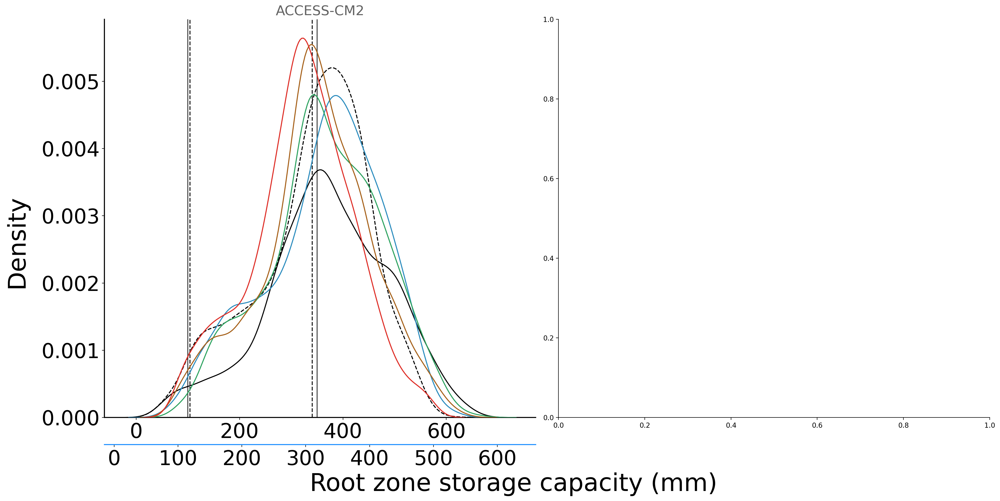

In [36]:
## With percentile equivalent threhold

fig, ax = plt.subplots(1,2, figsize=(20,10), dpi = 200)
fig.subplots_adjust(bottom=0.02)
sec_y_eq_100 = []
sec_y_eq_400 = []
color = ['#2b8cbe','#2ca25f','#a6611a','#de2d26']
for model, ax in zip(range(1), ax.flat):
    os.chdir(parent_dir+'Sr_estimates/historical/')
    temp_name = 'CMIP.'+df_final.iloc[model,0]+'.'+df_final.iloc[model,1]+'.'+'historical'+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
    #if df_final.iloc[model,1] == 'MPI-ESM1-2-HR':
    #    temp_name = 'MPI-M'+'.'+df_final.iloc[model,1]+'.'+'historical'+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
    temp_name = 'Sr-20year-return-period'+'.'+temp_name+'.2000-2014.nc'
    CMIP6_Sr_interp_historical = xr.open_dataset(temp_name).Sr.interp(lat=new_lat, lon=new_lon)
    df = pd.DataFrame({'Sr': Sr.sel(lat = slice(lat_min,lat_max), 
                                        lon = slice(lon_min,lon_max)).where(Landuse.sel(lat = slice(lat_min,lat_max), 
                                                                                        lon = slice(lon_min,lon_max)).values > 0).values.flatten(),
                           'Historical': CMIP6_Sr_interp_historical.sel(lat = slice(lat_min,lat_max), 
                                                             lon = slice(lon_min,lon_max)).where(Landuse.sel(lat = slice(lat_min,lat_max), 
                                                                                                             lon = slice(lon_min,lon_max)).values > 0).values.flatten()})
    SSP = 0
    for SSP in ['ssp126','ssp245','ssp370','ssp585']:
        if df_final[SSP].iloc[model] == 0:
            continue
        os.chdir(parent_dir+'Sr_estimates/'+SSP+'/')
        temp_name = 'ScenarioMIP.'+df_final.iloc[model,0]+'.'+df_final.iloc[model,1]+'.'+str(SSP)+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
        if (df_final.iloc[model,1] == 'MPI-ESM1-2-HR'):
            temp_name = 'ScenarioMIP.'+'DKRZ'+'.'+df_final.iloc[model,1]+'.'+str(SSP)+'.'+df_final.iloc[model,2]+'.'+df_final.iloc[model,3]
        if (df_final.iloc[model,1] == 'IITM-ESM'):
            if (SSP == 'ssp370'):
                CMIP6_Sr_interp_future = xr.open_dataset('Sr-20year-return-period'+'.'+temp_name+'.'+str(future_year_start)+'-'+str(2098)+'.nc').Sr.interp(lat=new_lat, lon=new_lon)
            else:
                CMIP6_Sr_interp_future = xr.open_dataset('Sr-20year-return-period'+'.'+temp_name+'.'+str(future_year_start)+'-'+str(2099)+'.nc').Sr.interp(lat=new_lat, lon=new_lon)
        else: 
            CMIP6_Sr_interp_future = xr.open_dataset('Sr-20year-return-period'+'.'+temp_name+'.'+str(future_year_start)+'-'+str(future_year_end)+'.nc').Sr.interp(lat=new_lat, lon=new_lon)
        #print(temp_name)

        CMIP6_Sr_interp_future = CMIP6_Sr_interp_future.where(Landuse.values > 0)

        # Converting to dataframe for analysis for 'South America' 
        df[SSP] = CMIP6_Sr_interp_future.sel(lat = slice(lat_min,lat_max), 
                                                             lon = slice(lon_min,lon_max)).where(Landuse.sel(lat = slice(lat_min,lat_max), 
                                                                                                             lon = slice(lon_min,lon_max)).values > 0).values.flatten()
        
    df = df.dropna()
    df_random  = df.sample(3000)
    df_random = remove_outliers(df_random, 'Sr')
    df_random = remove_outliers(df_random, 'Historical')
    
    for SSP in ['ssp126','ssp245','ssp370','ssp585']:
        if df_final[SSP].iloc[model] == 0:
            continue
        df_random = remove_outliers(df_random, SSP)

    sz = df_random['Sr'].size-1
    df_random['Sr_percentile'] = df_random['Sr'].rank(method='max').apply(lambda x: 100.0*(x-1)/sz)    
    df_random['Historical_percentile'] = df_random['Historical'].rank(method='max').apply(lambda x: 100.0*(x-1)/sz)    
    Sr_percentile_100 = df_random.loc[df_random['Sr'].sub(100).abs().idxmin()]['Sr_percentile']
    Historical_Sr_100 = df_random.loc[df_random['Historical_percentile'].sub(Sr_percentile_100).abs().idxmin()]['Historical']
    Sr_percentile_400 = df_random.loc[df_random['Sr'].sub(350).abs().idxmin()]['Sr_percentile']
    Historical_Sr_400 = df_random.loc[df_random['Historical_percentile'].sub(Sr_percentile_400).abs().idxmin()]['Historical']

    newax = ax.twiny()
    newax.set_frame_on(True)
    newax.patch.set_visible(False)
    newax.xaxis.set_ticks_position('bottom')
    newax.xaxis.set_label_position('bottom')
    newax.spines['bottom'].set_position(('outward', 40))
    ax.axvline(100, color = 'black', zorder = 2, alpha = 0.7)
    ax.axvline(350, color = 'black', zorder = 2, alpha = 0.7)
    sns.distplot(df_random['Sr'] , color="black", bins = 100, ax = ax, label = 'Observed', hist=False)
    sns.distplot(df_random['Historical'] , color="black", bins = 100, ax = newax, hist=False, label = 'CMIP6-Historical', kde_kws={'linestyle':'--'})
    sec_y_eq_100.append(Historical_Sr_100)
    newax.axvline(Historical_Sr_100, color = 'black', linestyle = '--', zorder = 2, alpha = 0.9)
    Historical_Sr_100 = 0
    sec_y_eq_400.append(Historical_Sr_400)
    newax.axvline(Historical_Sr_400, color = 'black', linestyle = '--', zorder = 2, alpha = 0.9)
    Historical_Sr_400 = 0
    
    color_i = 0
    for SSP in ['ssp126','ssp245','ssp370','ssp585']:
        if df_final[SSP].iloc[model] == 0:
            color_i = color_i+1
            continue
        sns.distplot(df_random[SSP] , color=color[color_i], bins = 100, ax = newax, hist=False, label = 'CMIP6-Future')
        color_i = color_i+1
        ax.set_title(df_final.iloc[model,1], fontsize = '20', color = '#636363')
        sns.despine()
        ax.tick_params(axis='both', which='major', labelsize=30)
        plt.setp(ax.spines.values(), linewidth=1.5)
        ax.set_xlabel(' ')
        newax.tick_params(axis='x', which='major', labelsize=30)
        newax.spines['bottom'].set_color('dodgerblue')

        plt.setp(newax.spines.values(), linewidth=1.5)
        ax.set_ylabel(' ')
        newax.set_xlabel(' ')
    """
    ax.annotate('p = '+'{0:.3f}'.format(mannwhitneyu(df['Sr'].sample(2000), df['Historical'].sample(2000))[1]), xy=(0.89, 0.9), 
                    xycoords='axes fraction', style='italic', fontsize=20, ha='right', va='bottom', zorder = 5)
    """
    """
    if (mannwhitneyu(df['Sr'].sample(2000), df['Historical'].sample(2000))[1] < 0.05):
        ax.annotate('p < 0.05', xy=(0.89, 0.9), xycoords='axes fraction', style='italic', fontsize=20, ha='right', va='bottom', zorder = 5, color = 'red')
    else:
        ax.annotate('p = '+'{0:.3f}'.format(mannwhitneyu(df['Sr'].sample(20), df['Historical'].sample(20))[1]), xy=(0.89, 0.9), 
                    xycoords='axes fraction', style='italic', fontsize=20, ha='right', va='bottom', zorder = 5)
    """

fig.text(0.5, -0.01, 'Root zone storage capacity (mm)', ha='center', fontsize = 36)

#fig.text(0.05, 1.01, 'Observation-based vs CMIP6-derived root zone storage capacity distribution for '+Country, fontsize = 36)
#fig.text(0.23735, 1.01, 'CMIP6-historical (2000-2014)', fontsize = 36, color = 'dodgerblue')
#fig.text(0.4858, 1.01, 'vs', fontsize = 36)
#fig.text(0.51, 1.01, 'CMIP6-'+SSP+' (2070-2100)', fontsize = 36, color = 'red') # Check the year
#fig.text(0.736, 1.01, ' for '+Country, fontsize = 36)

fig.text(-0.02, 0.5, 'Density', va='center', rotation='vertical', fontsize = 36)
#fig.text(0.5,1.018, '(Percentile-relative)', ha='center', fontsize = 25, color = '#636363')
plt.tight_layout()
fig.savefig(parent_dir+'/Figures/Supplementary_Fig7b.svg', dpi=300, bbox_inches="tight")

In [41]:
df_final

,institution_id,source_id,table_id,grid_label,historical,ssp126,ssp245,ssp370,ssp585,Sr-100eq,Sr-350eq
0,CSIRO-ARCCSS,ACCESS-CM2,Amon,gn,1,1,1,1,1,121.113881,310.662721
1,CSIRO,ACCESS-ESM1-5,Amon,gn,1,1,0,0,1,206.084287,295.555795
2,AWI,AWI-CM-1-1-MR,Amon,gn,1,1,1,1,1,121.608941,354.318473
3,BCC,BCC-CSM2-MR,Amon,gn,1,1,1,1,1,67.826050,134.381436
4,CAS,CAS-ESM2-0,Amon,gn,1,1,1,1,1,49.693557,220.267113
5,NCAR,CESM2-WACCM,Amon,gn,1,1,1,1,1,129.916378,316.431578
6,CMCC,CMCC-CM2-SR5,Amon,gn,1,1,1,1,1,110.769568,204.207156
7,CMCC,CMCC-ESM2,Amon,gn,1,1,1,1,1,122.625083,203.495422
8,CCCma,CanESM5,Amon,gn,1,1,1,1,1,258.612941,422.435308
9,E3SM-Project,E3SM-1-1,Amon,gr,1,0,0,0,1,110.789278,217.853644


In [42]:
df_final.to_csv(parent_dir+'CMIP6-Future_models_all_(with Sr-eq)_'+Country+'.csv', index = False)